In [ ]:
#sample

In [ ]:
from IPython.display import YouTubeVideo

# Change the Youtube_ID with the link to your group's video.
YOUTUBE_ID = 'XtA6FQz8BHQ'

YouTubeVideo(YOUTUBE_ID)

In [ ]:
!rm -rf youtube.mp4
# download the youtube with the given ID
!youtube-dl -f 'bestvideo[ext=mp4]' --output "youtube.%(ext)s" https://www.youtube.com/watch?v=$YOUTUBE_ID

In [ ]:
# cut the first 5 seconds
!ffmpeg -y -loglevel info -i youtube.mp4 -t 10 video.mp4

In [ ]:
#

In [29]:
!OpenFace/build/bin/FaceLandmarkVidMulti -f OpenFace/samples/multi_face.avi

Could not find the HAAR face detector location
Reading the landmark detector/tracker from: OpenFace/build/bin/model/main_ceclm_general.txt
Reading the landmark detector module from: OpenFace/build/bin/model/cen_general.txt
Reading the PDM module from: OpenFace/build/bin/model/pdms/In-the-wild_aligned_PDM_68.txt....Done
Reading the Triangulations module from: OpenFace/build/bin/model/tris_68.txt....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_0.25_of.dat....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_0.35_of.dat....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_0.50_of.dat....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_1.00_of.dat....Done
Reading part based module....left_eye_28
Reading the landmark detector/tracker from: OpenFace/build/bin/model/model_eye/main_c

# Producing Intermediate Files
### input videos
Short videos of *one* person, seated [insert calibration settings here].
### landmarked videos

### CSV with landmarked info
Output format as detailed at https://github.com/TadasBaltrusaitis/OpenFace/wiki/Output-Format/79e79cc5405d35b268e89f0564fe084ab972dc36. 

In [20]:
# clear any previous outputs.
#!rm -rf processed
# detect poses on the these 10 seconds.
!OpenFace/build/bin/FaceLandmarkVidMulti -f Test_001.mp4 -out_dir processed
# convert the result into MP4
!mkdir -p int_landmarked
!ffmpeg -y -loglevel info -i processed/Test_001.avi int_landmarked/Test_001.mp4

Could not find the HAAR face detector location
Reading the landmark detector/tracker from: OpenFace/build/bin/model/main_ceclm_general.txt
Reading the landmark detector module from: OpenFace/build/bin/model/cen_general.txt
Reading the PDM module from: OpenFace/build/bin/model/pdms/In-the-wild_aligned_PDM_68.txt....Done
Reading the Triangulations module from: OpenFace/build/bin/model/tris_68.txt....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_0.25_of.dat....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_0.35_of.dat....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_0.50_of.dat....Done
Reading the intensity CEN patch experts from: OpenFace/build/bin/model/patch_experts/cen_patches_1.00_of.dat....Done
Reading part based module....left_eye_28
Reading the landmark detector/tracker from: OpenFace/build/bin/model/model_eye/main_c

In [21]:
# To visualize result
def show_local_mp4_video(file_name, width=640, height=480):
  import io
  import base64
  from IPython.display import HTML
  video_encoded = base64.b64encode(io.open(file_name, 'rb').read())
  return HTML(data='''<video width="{0}" height="{1}" alt="test" controls>
                        <source src="data:video/mp4;base64,{2}" type="video/mp4" />
                      </video>'''.format(width, height, video_encoded.decode('ascii')))

show_local_mp4_video('int_landmarked/Test_001.mp4', width=960, height=720)

In [26]:
import pandas as pd
import matplotlib.pyplot as plt 
import sys
import numpy
from utils.util import *
#import seaborn as sns

In [23]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

#sns.set_style('white')

# Load data
df = pd.read_csv('processed/Test_001.csv')
# Remove empty spaces in column names.
df.columns = [col.replace(" ", "") for col in df.columns]
# Print few values of data.
print(f"Max number of frames {df.frame.max()}", f"\nTotal shape of dataframe {df.shape}")
df.head(10)

Max number of frames 691 
Total shape of dataframe (691, 714)


,frame,face_id,timestamp,confidence,success,gaze_0_x,gaze_0_y,gaze_0_z,gaze_1_x,gaze_1_y,...,AU12_c,AU14_c,AU15_c,AU17_c,AU20_c,AU23_c,AU25_c,AU26_c,AU28_c,AU45_c
0,1,0,0.000,0.98,1,0.053292,0.187855,-0.980750,-0.260260,0.241639,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
1,2,0,0.033,0.98,1,0.046771,0.194050,-0.979876,-0.263272,0.246275,...,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0
2,3,0,0.067,0.98,1,0.052516,0.189070,-0.980558,-0.260418,0.253959,...,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
3,4,0,0.100,0.98,1,0.050740,0.186545,-0.981135,-0.245932,0.249549,...,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
4,5,0,0.133,0.98,1,0.054561,0.188617,-0.980534,-0.257662,0.250255,...,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
5,6,0,0.167,0.98,1,0.055556,0.190139,-0.980184,-0.248700,0.250626,...,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
6,7,0,0.200,0.98,1,0.051693,0.189961,-0.980430,-0.276459,0.246906,...,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
7,8,0,0.233,0.98,1,0.055783,0.192170,-0.979775,-0.261876,0.248647,...,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
8,9,0,0.267,0.98,1,0.054884,0.193094,-0.979644,-0.273728,0.244176,...,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
9,10,0,0.300,0.98,1,0.059682,0.190506,-0.979870,-0.269724,0.242224,...,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0


Q1
Max number of frames 316 
Total shape of dataframe (316, 714)
Q2
Max number of frames 433 
Total shape of dataframe (433, 714)
Q3
Max number of frames 332 
Total shape of dataframe (332, 714)
Q4
Max number of frames 280 
Total shape of dataframe (280, 714)
CC
Max number of frames 325 
Total shape of dataframe (325, 714)
plot saved to: figs/test123.jpg
Q1
gaze_0_x    0.217187
gaze_0_y    0.137636
gaze_0_z   -0.966345
Name: avg, dtype: float64
gaze_0_x    0.004653
gaze_0_y    0.006450
gaze_0_z    0.001113
Name: stdev, dtype: float64
Q2
gaze_0_x    0.076460
gaze_0_y    0.161792
gaze_0_z   -0.983764
Name: avg, dtype: float64
gaze_0_x    0.011628
gaze_0_y    0.006845
gaze_0_z    0.001820
Name: stdev, dtype: float64
Q3
gaze_0_x    0.212621
gaze_0_y    0.175093
gaze_0_z   -0.961295
Name: avg, dtype: float64
gaze_0_x    0.004474
gaze_0_y    0.005050
gaze_0_z    0.001120
Name: stdev, dtype: float64
Q4
gaze_0_x    0.123648
gaze_0_y    0.230884
gaze_0_z   -0.964988
Name: avg, dtype: float64
ga

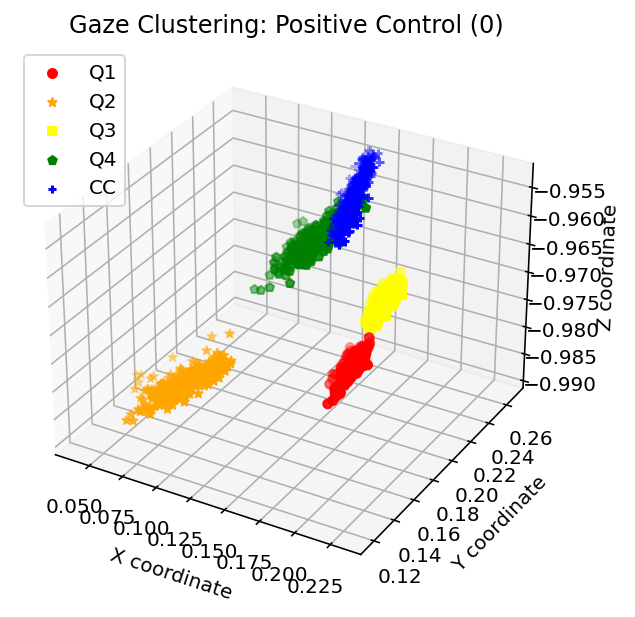

In [29]:
names = ['Q1', 'Q2', 'Q3', 'Q4', 'CC']
for name in names:
    load_data(name)
d_cal = calibration_data(names)
path = plot_calibration_data(d_cal, "test123")
print("plot saved to: " + path)
d_stats = compute_stats(d_cal)
for name in names:
    print(name)
    print(d_stats[name].loc['avg'])
    print(d_stats[name].loc['stdev'])

In [25]:
df_gv = df[["confidence","gaze_0_x", "gaze_0_y","gaze_0_z"]]
df_gv

,confidence,gaze_0_x,gaze_0_y,gaze_0_z
0,0.98,0.053292,0.187855,-0.980750
1,0.98,0.046771,0.194050,-0.979876
2,0.98,0.052516,0.189070,-0.980558
3,0.98,0.050740,0.186545,-0.981135
4,0.98,0.054561,0.188617,-0.980534
...,...,...,...,...
686,0.98,0.073891,0.243860,-0.966991
687,0.98,0.070686,0.235912,-0.969200
688,0.98,0.066228,0.253550,-0.965052
689,0.98,0.055602,0.246231,-0.967615


In [30]:
results=[]
for index, row in df_gv.iterrows():
    conf_x, error = find_zscore(d_stats, [row["gaze_0_x"],row["gaze_0_y"],row["gaze_0_z"]])
    results.append(min(error, key=error.get))
results

['Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q4',
 'Q4',
 'Q4',
 'CC',
 'CC',
 'CC',
 'CC',
 'CC',
 'CC',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'CC',
 'CC',
 'CC',
 'CC',
 'CC',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q2',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q4',
 'Q2',
 'Q4',
 'Q4',

In [ ]:
ax1 = df.plot.scatter(x='gaze_0_x', y='gaze_0_y', c='DarkBlue')

# Plotting

In [4]:
# Load data
df_Q1 = pd.read_csv('processed/Q1_A.csv')
df_Q2 = pd.read_csv('processed/Q2_A.csv')
df_Q3 = pd.read_csv('processed/Q3_A.csv')
df_Q4 = pd.read_csv('processed/Q4_A.csv')
df_CC = pd.read_csv('processed/CC_A.csv')

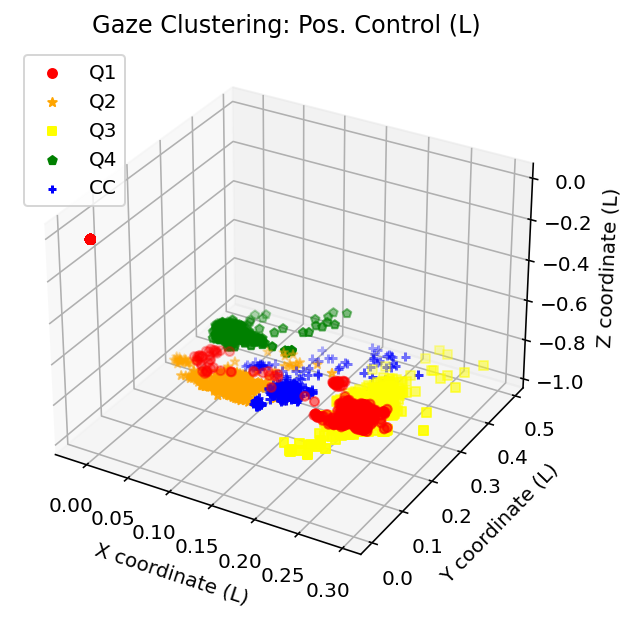

In [18]:
title = 'Gaze Clustering: Pos. Control (L)'
tag = 'PosCon_L-Cal_A'
fig0 = plt.figure(figsize=(5, 5))
ax = fig0.add_subplot(projection='3d')
ax.set_title(title)
ax.set_xlabel('X coordinate (L)')
ax.set_ylabel('Y coordinate (L)')
ax.set_zlabel('Z coordinate (L)')
ax.scatter(df_Q1['gaze_0_x'], df_Q1['gaze_0_y'], df_Q1['gaze_0_z'], color='red', marker='o', label='Q1')
ax.scatter(df_Q2['gaze_0_x'], df_Q2['gaze_0_y'], df_Q2['gaze_0_z'], color='orange', marker='*', label='Q2')
ax.scatter(df_Q3['gaze_0_x'], df_Q3['gaze_0_y'], df_Q3['gaze_0_z'], color='yellow', marker='s', label='Q3')
ax.scatter(df_Q4['gaze_0_x'], df_Q4['gaze_0_y'], df_Q4['gaze_0_z'], color='green', marker='p', label='Q4')
ax.scatter(df_CC['gaze_0_x'], df_CC['gaze_0_y'], df_CC['gaze_0_z'], color='blue', marker='+', label='CC')
ax.legend(loc="upper left")
plt.savefig('figs/'+tag+'.jpg')

In [10]:
def compute_stats(df):
    return df[['gaze_0_x','gaze_0_y','gaze_0_z']].quantile([0.01, 0.25, 0.5, 0.75, 0.99])

In [17]:
d = compute_stats(df_Q1)
d

,gaze_0_x,gaze_0_y,gaze_0_z
0.01,0.000000,0.000000,-0.960359
0.25,0.166747,0.230496,-0.947435
0.50,0.204404,0.260926,-0.939537
0.75,0.214206,0.274910,-0.934587
0.99,0.237113,0.326364,0.000000


In [19]:
import statistics
d.loc['avg'] = [statistics.mean(d['gaze_0_x']), statistics.mean(d['gaze_0_y']), statistics.mean(d['gaze_0_z'])]
d

,gaze_0_x,gaze_0_y,gaze_0_z
0.01,0.000000,0.000000,-0.960359
0.25,0.166747,0.230496,-0.947435
0.5,0.204404,0.260926,-0.939537
0.75,0.214206,0.274910,-0.934587
0.99,0.237113,0.326364,0.000000
avg,0.164494,0.218539,-0.756384


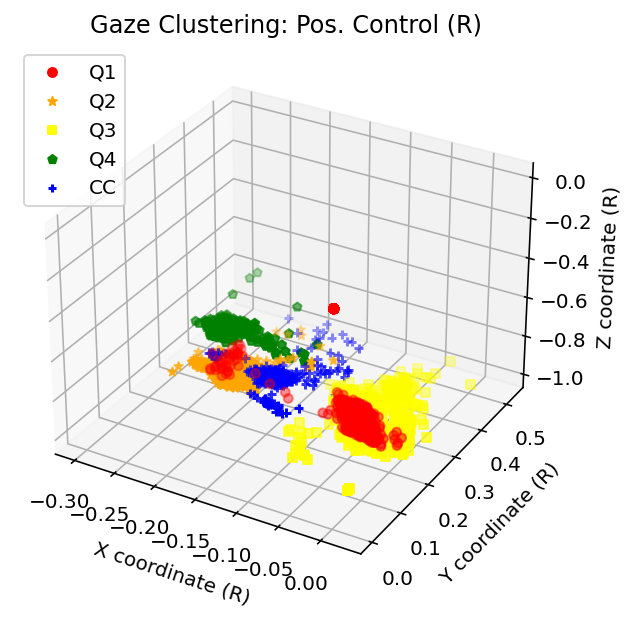

In [31]:
title='Gaze Clustering: Pos. Control (R)'
tag = 'PosCon_R-Cal_A'

fig1 = plt.figure(figsize=(5, 5))
ax = fig1.add_subplot(projection='3d')
ax.set_title(title)
ax.set_xlabel('X coordinate (R)')
ax.set_ylabel('Y coordinate (R)')
ax.set_zlabel('Z coordinate (R)')
ax.scatter(df_Q1['gaze_1_x'], df_Q1['gaze_1_y'], df_Q1['gaze_1_z'], color='red', marker='o', label='Q1')
ax.scatter(df_Q2['gaze_1_x'], df_Q2['gaze_1_y'], df_Q2['gaze_1_z'], color='orange', marker='*', label='Q2')
ax.scatter(df_Q3['gaze_1_x'], df_Q3['gaze_1_y'], df_Q3['gaze_1_z'], color='yellow', marker='s', label='Q3')
ax.scatter(df_Q4['gaze_1_x'], df_Q4['gaze_1_y'], df_Q4['gaze_1_z'], color='green', marker='p', label='Q4')
ax.scatter(df_CC['gaze_1_x'], df_CC['gaze_1_y'], df_CC['gaze_1_z'], color='blue', marker='+', label='CC')
ax.legend(loc="upper left")
plt.savefig('figs/'+tag+'.jpg')

In [31]:
# MISC

In [ ]:
# see label definitions at https://github.com/TadasBaltrusaitis/OpenFace/wiki/Output-Format/79e79cc5405d35b268e89f0564fe084ab972dc36

numpy.set_printoptions(threshold=sys.maxsize)
print((df.columns).tolist())